<h1>Aplicación de modelos convolucionales basados en U-Net para la segmentación de imágenes usando los conjuntos de datos Montgomery y Shenzhen - Aprendizaje Automático 1-2024</h1>

* <h5>Nombre: John Serrano Carrasco</h3>
* <h5>Profesora: Violeta Chang Camacho</h3>
* <h5>Ayudante: Bryan Salas Valenzuela</h3>

<h2>Breve Contexto</h2>
El objetivo de esta tarea es familiarizarse con la implementación, entrenamiento y evaluación de modelos convolucionales basados en U-net para la segmentación de imágenes. Así, se deberán entrenar dos diferentes arquitecturas convolucionales para la segmentación de imágenes médicas.
Se requiere utilizar los modelos <b>U-Net</b> y <b>U-Net++</b> para la experiencia, utilizando imágenes de los conjuntos de datos Montgomery y Shenzhen. Respecto a los modelos y datos:

* Los datos se dividirán en datos de entrenamiento (80%) y prueba (20%).
* Como optimizador se ocupará Adam o SGD con los parámetros por defecto, justificando debidamente la elección de uno de los dos optimizadores.* Los modelos serán entrenados por al menos 10 épocas cada uno * Se utilizará a un tamaño de lote de 32. 
* Gráfico épocas vs. pérdida (epoch vs. loss) y épocas vs. Dice (epoch vs. Dice), para cada una de las redes descritas.* Coeficiente de Dice obtenido por cada modelo.

<h2>Importaciones de Librerias</h2>
Se importan todas las librerias necesarias para ejecutar los códigos a continuación.

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torch.utils.data import TensorDataset
from torchvision.io import read_image
import torch.optim as optim
from sklearn.model_selection import train_test_split
import segmentation_models_pytorch as smp
from PIL import Image
import random

<h2>Definición de semilla</h2>
Se define una semilla para asegurar reproducibilidad y evitar aleatoriedad en los resultados. Para ello, se utiliza el número 169 como semilla y se define para el generador de números aleatorios de NumPy, para los operaciones aleatorias en PyTorch y para el generador de números aleatorios de Python.

In [2]:
'''
Entrada: No tiene.
Salida: No tiene como tal, pero coloca una semilla (seed).
Descripción: Función que define una semilla (169) para asegurar reproducibilidad y evitar aleatoriedad en los resultados.
'''
def set_seed():
    random.seed(169)
    np.random.seed(169)
    torch.manual_seed(169)
    torch.cuda.manual_seed(169)
    torch.cuda.manual_seed_all(169)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

<h2>Uso de GPU y PyTorch para la experiencia</h2>
A diferencia de los laboratorios anteriores, para este laboratorio se hará uso de una GPU correspondiente a <b>NVIDIA RTX 3060</b>, cuya potencia es importante para obtener buenos resultados y ahorrar tiempo de ejecución. También se utilizará PyTorch, que permite rápidamente utilizar la GPU para entrenamiento y validación, además de ya tener implementaciones de U-Net y U-Net++ que pueden ser utilizadas gracias a Segmentation Models.

In [3]:
# Se muestra información sobre las GPUs NVIDIA disponibles en el sistema
!nvidia-smi

Sun Aug 25 17:38:13 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.94                 Driver Version: 560.94         CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3060 ...  WDDM  |   00000000:01:00.0 Off |                  N/A |
| N/A   49C    P8              9W /   80W |       0MiB /   6144MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [4]:
# Verifica si una GPU está disponible y, si es así, configura el dispositivo para usar CUDA.
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# Imprime en la consola el dispositivo que se utilizará (CUDA o CPU).
print(f"Using device: {device}")

Using device: cuda


In [5]:
# Retorna True si al menos una GPU está disponible, de lo contrario, retorna False
torch.cuda.is_available()

True

<h3>Lectura de datos "Images" y "Masks"</h3>

Se define la función <b>loadImages()</b> para cargar las imágenes y sus etiquetas correspondientes.  La función recorre una lista de nombres de archivos de imagen, carga cada imagen desde el directorio especificado,  la normaliza dividiendo los valores de píxel por 255.0 para que estén entre 0 y 1, aplica una transformación adicional definida por la variable transform, y finalmente apila todas las imágenes en un solo tensor 4D.

In [6]:
'''
Entradas: Una lista de nombres de archivos de imagen a cargar y un directorio donde se encuentran las imágenes.
Salida: Un tensor 4D de PyTorch que contiene todas las imágenes cargadas y procesadas.
Descripción: Carga y procesa un conjunto de imágenes.
'''
def loadImages(image_list, image_dir, transform):
    images = []
    for img_name in image_list:
        img_path = os.path.join(image_dir, img_name)
        # Carga la imagen usando PIL
        image = Image.open(img_path).convert("L") 
        # Redimensiona la imagen a 128 x 128
        image = image.resize((128, 128))
        # Convierte a un tensor y normaliza
        image = torch.tensor(np.array(image)).float() / 255.0
        # Aplica la transformación
        image = transform(image.unsqueeze(0))
        images.append(image)
    return torch.stack(images)

Primero se definen los directorios de imágenes y máscaras, lista y ordena los archivos, y luego carga y procesa las imágenes aplicando las transformaciones necesarias, devolviéndolas como tensores listos para su uso en el modelo.

In [7]:
# Se definen los directorios de imágenes y máscaras
images_dir = "Images/Lungs"
masks_dir = "Masks/Lungs"

# Se define la transformación (adaptación a 128 x 128)
transform = transforms.Compose([
    transforms.Resize((128, 128)),
])

# Se listan las imágenes y máscaras
image_paths = sorted(os.listdir(images_dir))
mask_paths = sorted(os.listdir(masks_dir))

# Se cargan las imágenes y máscaras
images = loadImages(image_paths, images_dir, transform)
masks = loadImages(mask_paths, masks_dir, transform)

<h2>División entre conjuntos de entrenamiento y prueba</h2>
Se divide aleatoriamente el conjunto de imágenes y sus máscaras correspondientes en dos subconjuntos: uno para entrenamiento y otro para validación, utilizando el 80% de los datos para entrenamiento y el 20% para validación usando la función train_test_split(). Finalmente, imprime el número de imágenes en cada subconjunto para verificar la división realizada.

In [8]:
# Se utiliza set_seed() para asegurar reproducibilidad
set_seed()

# Se divide las imágenes y máscaras en conjuntos de entrenamiento y validación.
train_images, val_images, train_masks, val_masks = train_test_split(
    images, masks, test_size=0.2, random_state=169
)

# Se imprime la cantidad de imágenes en el conjunto de entrenamiento y conjunto de prueba
print(f"{len(train_images)} Training images")
print(f"{len(val_masks)} Testing images")

541 Training images
136 Testing images


In [9]:
# Crea un conjunto de datos de entrenamiento y de prueba emparejando las imágenes y máscaras correspondientes.
train_dataset = TensorDataset(train_images, train_masks)
val_dataset = TensorDataset(val_images, val_masks)

# Se crea un DataLoader para el conjunto de entrenamiento y para el conjunto de prueba, que organiza los datos en lotes
# de tamaño 32 y los baraja en cada época.
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

<h2>U-Net utilizando el optimizador Adam</h2>
En primer lugar, se va a comenzar con el modelo U-Net utilizando el optimizador Adam. Para ello, se utiliza la implementación de Segmentation Models, que funciona muy bien con PyTorch y permite inmediatamente poder configurar y utilizar el modelo. Para la creación de los modelos y sus distintas configuraciones, se crea la función <b>createModel()</b>. Esta función luego será reutilizada cada vez que se quiera utilizar el optimizador SGD y también a la hora de aplicar el modelo U-Net++

In [10]:
'''
Entrada: Un entero que indica el tipo de modelo a utilizar (1 para U-Net, 2 para U-Net++), otro entero que indica la función 
de pérdida a utilizar (1 para BCEWithLogitsLoss, 2 para DiceLoss) y un entero que indica el optimizador a 
utilizar (1 para Adam, 2 para SGD).
Salida: Devuelve un modelo con las configuraciones seleccionadas, una función de pérdida y un optimizador.
Descripción: Crea y configura un modelo de segmentación, función de pérdida y optimizador según las opciones proporcionadas.
'''
def createModel(num_model, num_loss, num_optim):
    set_seed()
    if num_model == 1:
        model = smp.Unet(
            encoder_name="resnet34",        # Utiliza ResNet34 como codificador
            encoder_weights="imagenet",     # Usa pesos preentrenados en ImageNet
            classes=1,                      # Número de clases de salida (1 por clasificación binaria)
            in_channels=1,                  # Número de canales de entrada
        ).to(device)                        # Mueve el modelo a la GPU
    elif num_model == 2:
        model = smp.UnetPlusPlus(           # Similar a la opción anterior, solo que se crea un modelo U-Net++
            encoder_name = 'resnet34',     
            encoder_weights = 'imagenet',  
            classes = 1,                    
            in_channels=1,                  
        ).to(device)                        

    # Selección de la función de pérdida según el valor de num_loss
    if num_loss == 1:
        loss_fn = nn.BCEWithLogitsLoss()    # Función de pérdida BCEWithLogitsLoss
    elif num_loss == 2:
        loss_fn = smp.losses.DiceLoss(mode='binary')    # Función de pérdida DiceLoss

    # Selección del optimizador según el valor de num_optim
    if num_optim == 1:
        optimizer = torch.optim.Adam(model.parameters())  # Optimización con Adam
    elif num_optim == 2:
        optimizer = optim.SGD(model.parameters())          # Optimización con SGD

    return model, loss_fn, optimizer 

Se utiliza la función createModel() con las opciones 1, 1, 1 para crear un modelo U-Net que utilice un optimizador ADAM y una función de pérdida BCEWithLogitsLoss

In [11]:
# Creación del modelo U-Net con optimizador Adam y BCEWithLogitsLoss
model_unet_adam, loss_fn, optimizer = createModel(1, 1, 1)
model_unet_adam

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track

<h2>Entrenamiento, evaluación y Coeficiente de Dice</h2>

En primer lugar, se define la función <b>diceCoef()</b> que cálcula el Coeficiente de Dice, el cual es una medida de la similitud entre dos conjuntos y es comúnmente utilizado en tareas de segmentación de imágenes para evaluar la precisión entre máscaras predichas y reales.

In [12]:
'''
Entrada: Un tensor de predicciones del modelo y un tensor de etiquetas objetivo. Por defecto, se tiene un número pequeño
para evitar divisiones por cero.
Salida: Retorna un valor flotante que representa el Coeficiente de Dice calculado.
Descripción: Calcula el Coeficiente de Dice entre las predicciones y las etiquetas objetivo.
'''
def diceCoef(pred, target, smooth=1e-6):
    # Asegura que los tensores de predicción y objetivo estén contiguos en memoria y los aplana en un solo vector 1D.
    pred = pred.contiguous().view(-1)
    target = target.contiguous().view(-1)
    
    # Calcula la intersección (elementos en común) entre la predicción y el objetivo.
    intersection = (pred * target).sum()
    
    # Calcula el Coeficiente de Dice usando la fórmula:
    # 2 * intersección / (suma de los elementos en pred y target), con un valor 'smooth' para evitar la división por cero.
    dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
    
    return dice.item()

Se define la función <b>trainAndEvaluate()</b>, la cual entrena y evalúa un modelo de segmentación de imágenes durante un número especificado de épocas. En cada época, el modelo ajusta sus parámetros usando el conjunto de datos de entrenamiento, calcula el valor de loss y luego evalúa su rendimiento en un conjunto de validación calculando tanto el valor de loss como el Coeficiente de Dice. La función registra y devuelve el historial de loss y coeficientes de dice para cada época, lo que permite monitorizar el rendimiento del modelo a lo largo del tiempo.

In [13]:
'''
Entrada: Un modelo de segmentación que se va a entrenar y evaluar, un dataLoader que proporciona los datos de entrenamiento, un
dataLoader que proporciona los datos de validación, un optimizador, una función de pérdida y por defecto un número de épocas con valor 30.
Salida: Retorna el historial de valores de loss de entrenamiento, loss de evaluación y coeficiente de dice.
Descripción: Entrena y evalúa un modelo de segmentación a lo largo de un número de épocas especificado. Se obtiene los valores de loss
en el entrenamiento y evaluación, junto con el valor de coeficiente de dice correspondiente.
'''
def trainAndEvaluate(model, train_loader, val_loader, optimizer, loss_fn, num_epochs=30):
    set_seed()
    # Inicializa listas para almacenar los valores de loss y coeficiente de dice
    train_loss_history = []
    val_loss_history = []
    dice_score_history = []

    for epoch in range(num_epochs):
        # Se establece el modelo en modo de entrenamiento
        model.train()
        train_loss = 0
        for images, masks in train_loader:
            # Se mueven las imágenes y mascaras a la GPU
            images = images.to(device)
            masks = masks.to(device)
            # Se resetean los gradientes del optimizador
            optimizer.zero_grad()
            # Realiza una predicción con el modelo
            outputs = model(images)
            # Calcula el valor de loss
            loss = loss_fn(outputs, masks)
            # Calcula los gradientes mediante backpropagation
            loss.backward()
            # Actualiza los pesos del modelo
            optimizer.step()
            # Acumula la pérdida multiplicada por el tamaño del lote
            train_loss += loss.item() * images.size(0)

        # Calcula y guarda el valor de loss promedio de entrenamiento para la época
        train_loss /= len(train_loader.dataset)
        train_loss_history.append(train_loss)

        # Establece el modelo en modo de evaluación
        model.eval()
        val_loss = 0
        dice_score = 0
        # Desactiva el cálculo de gradientes para la validación
        with torch.no_grad():
            for images, masks in val_loader:
                # Nuevamente se mueven las imágenes y mascaras a la GPU
                images = images.to(device)
                masks = masks.to(device)
                # Realiza una predicción con el modelo
                outputs = model(images)
                # Calcula el valor de loss de la evaluación
                loss = loss_fn(outputs, masks)
                val_loss += loss.item() * images.size(0)

                # Calcula el coeficiente de Dice
                outputs = torch.sigmoid(outputs)
                outputs = (outputs > 0.5).float()
                dice_score += diceCoef(outputs, masks)
        # Calcula la loss promedio de validación y el Coeficiente de Dice para la época
        val_loss /= len(val_loader.dataset)
        dice_score /= len(val_loader)

        # Guarda el valor de loss de validación y el Coeficiente de Dice
        val_loss_history.append(val_loss)
        dice_score_history.append(dice_score)

        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, Dice Score: {dice_score:.4f}")
    
    return train_loss_history, val_loss_history, dice_score_history

<h3>Entrenamiento, evaluaciones y coeficiente de dice de U-Net utilizando Adam</h3>
Se realiza el llamado a la función <b>trainAndEvaluate()</b> usando el <b>modelo U-Net con optimizador Adam</b>. Se puede ver a continuación los resultados en cada época, es decir, los valores de loss de entrenamiento, loss de evaluación y Coeficiente de Dice.

In [14]:
# Se obtienen los resultados de U-Net con el optimizador Adam y la función de pérdida BCEWithLogitsLoss.
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unet_adam, train_loader, val_loader, optimizer, loss_fn)

Epoch 1/30, Train Loss: 0.3803, Val Loss: 0.3630, Dice Score: 0.8141
Epoch 2/30, Train Loss: 0.1713, Val Loss: 0.1533, Dice Score: 0.9230
Epoch 3/30, Train Loss: 0.1071, Val Loss: 0.0877, Dice Score: 0.9533
Epoch 4/30, Train Loss: 0.0816, Val Loss: 0.0713, Dice Score: 0.9567
Epoch 5/30, Train Loss: 0.0701, Val Loss: 0.0650, Dice Score: 0.9582
Epoch 6/30, Train Loss: 0.0617, Val Loss: 0.0618, Dice Score: 0.9590
Epoch 7/30, Train Loss: 0.0576, Val Loss: 0.0584, Dice Score: 0.9591
Epoch 8/30, Train Loss: 0.0556, Val Loss: 0.0603, Dice Score: 0.9558
Epoch 9/30, Train Loss: 0.0540, Val Loss: 0.0593, Dice Score: 0.9574
Epoch 10/30, Train Loss: 0.0516, Val Loss: 0.0581, Dice Score: 0.9556
Epoch 11/30, Train Loss: 0.0476, Val Loss: 0.0569, Dice Score: 0.9588
Epoch 12/30, Train Loss: 0.0452, Val Loss: 0.0537, Dice Score: 0.9602
Epoch 13/30, Train Loss: 0.0432, Val Loss: 0.0522, Dice Score: 0.9618
Epoch 14/30, Train Loss: 0.0414, Val Loss: 0.0571, Dice Score: 0.9597
Epoch 15/30, Train Loss: 0.04

<h3>Gráfico de Epoch VS Loss usando U-Net con Adam</h3>
Se crea y utiliza la función <b>plotTrainLoss()</b> que muestra un gráfico de como cambia el valor de loss por cada epoch.

In [15]:
'''
Entrada: El número de épocas utilizadas, el historial de valores de loss de entrenamiento y el nombre del modelo utilizado
Salida: No tiene como tal, pero muestra un gráfico que compara epoch vs loss
Descripción: Se crea un gráfico que muestra como cambia el valor de loss de entrenamiento por cada epoca.
'''
def plotTrainLoss(num_epochs, train_loss_history, model_name):
    plt.figure(figsize=(8, 6))
    plt.plot(range(num_epochs), train_loss_history, label='Train Loss', color='blue')
    plt.xlabel('Epochs')
    plt.ylabel('Train Loss')
    plt.title('Train Loss vs Epoch ' + model_name)
    plt.legend()
    plt.grid(True)
    plt.show()

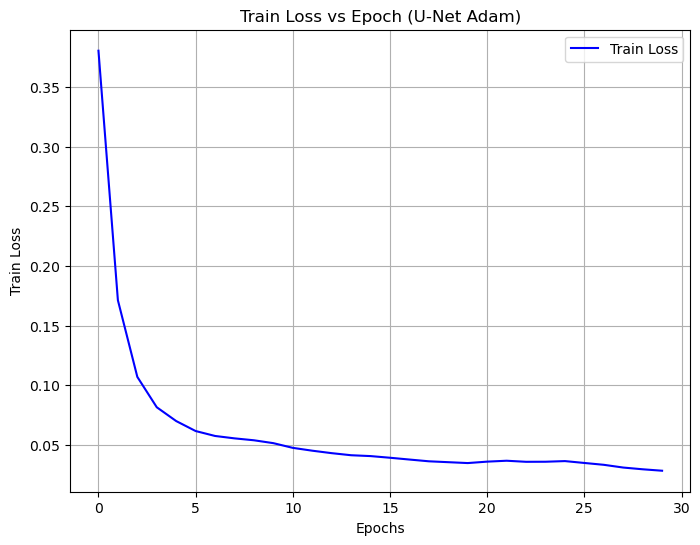

In [16]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net usando Adam.
plotTrainLoss(30, train_loss_history, '(U-Net Adam)')

<h3>Gráfico de Coeficiente de Dice VS Epoch usando U-Net con Adam</h3>
Se crea y utiliza la función <b>plotDiceEpoch()</b> que muestra un gráfico de como cambia el valor de Coeficiente de Dice por cada epoch.

In [17]:
'''
Entrada: El número de épocas utilizadas, el historial de valores de coeficiente de dice y el nombre del modelo utilizado
Salida: No tiene como tal, pero muestra un gráfico que compara epoch vs Coeficiente de Dice
Descripción: Se crea un gráfico que muestra como cambia el valor de Coeficiente de Dice por cada epoca.
'''
def plotDiceEpoch(num_epochs, dice_score_history, model_name):
    plt.figure(figsize=(8, 6))
    plt.plot(range(num_epochs), dice_score_history, label='Dice Score', color='green')
    plt.xlabel('Epochs')
    plt.ylabel('Dice Score')
    plt.title('Dice Score vs Epoch ' + model_name)
    plt.legend()
    plt.grid(True)
    plt.show()

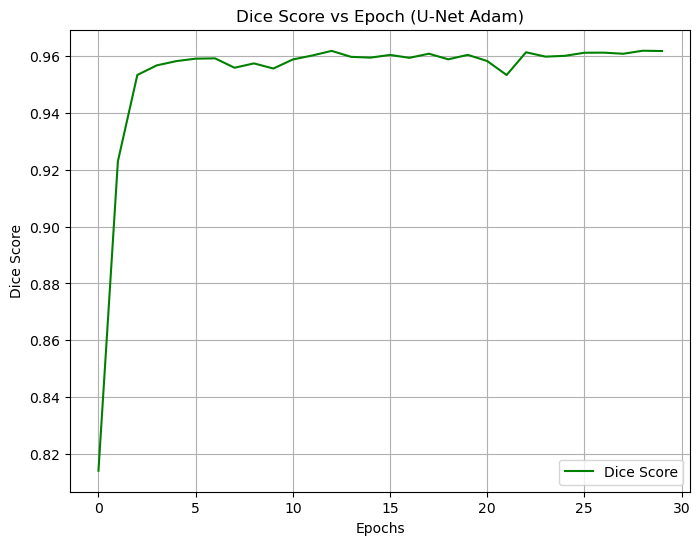

In [18]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net usando Adam.
plotDiceEpoch(30, dice_score_history, '(U-Net Adam)')

<h3>Visualización de resultados de U-Net con optimizador Adam</h3>
Se crea la función <b>visualizeAllTestImages()</b>, la cual evalúa y visualiza las predicciones de un modelo de segmentación sobre un conjunto de imágenes de prueba. Para cada imagen, muestra la imagen original, la máscara verdadera y la predicción superpuestas en un grid de subplots. También calcula el coeficiente de Dice para cada imagen, una métrica que mide la precisión de la segmentación. La función se detiene después de visualizar 136 imágenes y retorna una lista con los Coeficientes de Dice calculados, lo que permite analizar el rendimiento del modelo de manera visual y cuantitativa. El color verde coresponde a lo que faltó por segmentar, el rojo fue lo sobresegmentado y el amarillo es lo correctamente segmentado.

In [19]:
'''
Entrada: El modelo de segmentación que se utilizará para hacer predicciones y un DataLoader que proporciona los datos de prueba en batches.
Salida: Retorna una lista de Coeficientes de Dice calculados para cada imagen del conjunto de prueba visualizada, junto con las imágenes 
correspondientes donde se pueden apreciar las predicciones realizadas.
Descripción: Visualiza las predicciones del modelo sobre un conjunto de imágenes de prueba y calcula el Coeficiente de Dice para cada imagen. El 
verde marca lo que faltó por segmentar, el rojo lo que fue sobresegmentado y el amarillo (superposición del verde y rojo), lo correctamente 
segmentado.
'''
def visualizeAllTestImages(model, dataloader):
    set_seed()
    # Coloca el modelo en modo de evaluación
    model.eval()
    # Número de columnas en los subplots
    ncols = 8 
    # Calcula el número necesario de filas para las 136 imágenes
    nrows = (136 // ncols) + (1 if 136 % ncols > 0 else 0) 

    # # Configura la figura y los subplots para mostrar correctamente las imágenes
    fig, axes = plt.subplots(nrows, ncols, figsize=(20, nrows * 2.5))
    axes = axes.flatten()
    
    images_shown = 0
    dices_list = []
    images_results = []
    
    # Se desactiva el cálculo de gradientes
    with torch.no_grad():
        
        for images, masks in dataloader:
            # Se mueven las imágenes y mascaras a la GPU
            images = images.to(device)
            masks = masks.to(device)
            # Genera predicciones con el modelo
            outputs = model(images)
            # Aplica la función sigmoide a las salidas
            outputs = torch.sigmoid(outputs)
            # Binariza las predicciones con un umbral de 0.5
            outputs = (outputs > 0.5).float()
            
            for i in range(images.size(0)):
                # Obtiene la predicción y la convierte a numpy
                pred = outputs[i].cpu().numpy().squeeze()
                # Obtiene la máscara verdadera y la convierte a numpy
                true_mask = masks[i].cpu().numpy().squeeze()
                # Obtiene la imagen original y la convierte a numpy
                input_image = images[i].cpu().numpy().squeeze()

                # Se crea una imagen RGB para la superposición de colores
                result = np.zeros((input_image.shape[0], input_image.shape[1], 3))

                # Rojo que corresponde a la predicción realizada
                result[:, :, 0] = pred  
                # Verde que corresponde a la mascara original
                result[:, :, 1] = true_mask
                # Amarillo donde coinciden (pred * true_mask)
                result = np.clip(result, 0, 1)
                
                # Se cálcula el Coeficiente de Dice correspondiente a la imágen y se guarda en una lista
                dice_score = diceCoef(torch.tensor(pred), torch.tensor(true_mask))
                dices_list.append(dice_score)
                
                # Se visuaalizan las imágenes en subplots. En cada imágen se muestra el coeficiente de dice asociado
                ax = axes[images_shown]
                ax.imshow(input_image, cmap = 'gray',  vmin=0, vmax=1)
                ax.imshow(result, alpha=0.5)
                ax.set_title(f'Dice: {dice_score:.4f}')
                ax.axis('off')
                images_shown += 1
                images_results.append((input_image, true_mask, pred, dice_score))
                # El proceso se detiene cuando se llegan a las 136 imágenes (conjunto de prueba en su totalidad)
                if images_shown >= 136:
                    break
                    
            if images_shown >= 136:
                break
    # Se muestran las imágenes correspondientes
    plt.tight_layout()
    plt.show()
    return dices_list, images_results

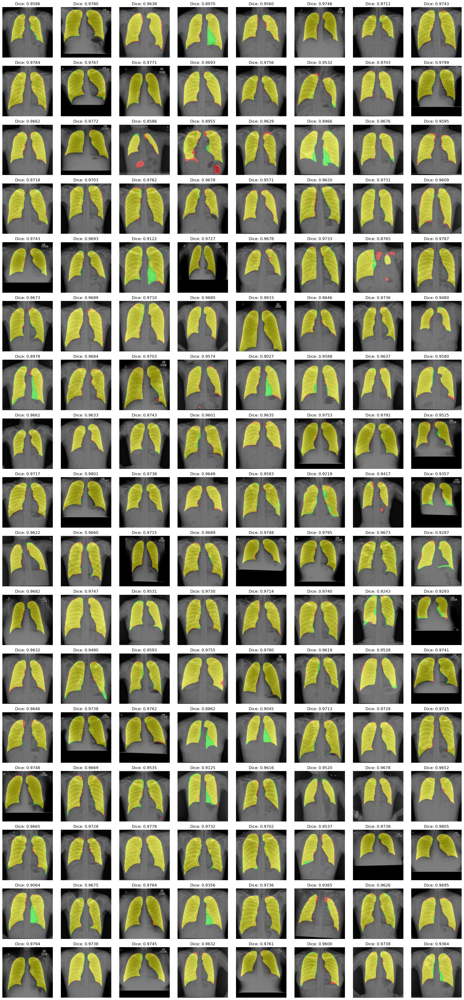

In [20]:
# Se obtienen los resultados y Coeficientes de Dice del modelo U-Net que utiliza el optimizador Adam
dice_list_unet_adam, images_results_unet_adam = visualizeAllTestImages(model_unet_adam, val_loader)

<h3>5 casos dificiles y 5 casos fáciles con U-Net utilizando el optimizador Adam</h3>
Se crea y utiliza la función <b>visualizeBestWorstImages()</b>, que permite visualizar y comparar las 5 mejores y las 5 peores predicciones de un modelo de segmentación de imágenes, ordenadas según el coeficiente de Dice. Muestra estas imágenes en una cuadrícula de subplots, superponiendo la predicción del modelo y la máscara verdadera sobre la imagen original. Los 5 mejores resultados son los que al modelo se le hizo facil predecir, mientras que las 5 peores son aquellas donde el modelo encontró dificil hacer la predicción correcta.

In [21]:
'''
Entrada: Una lista de tuplas, donde cada tupla contiene input_image, true_mask, pred y dice_score para cada imagen evaluada.
Salida: No tiene como tal, pero muestra subplots correspondientes a las predicciones realizadas y sus respectivas imágenes
Descripción: Visualiza las mejores (casos fáciles) y peores (casos dificiles) predicciones del modelo según el Coeficiente de Dice.
'''
def visualizeBestWorstImages(images_results):
    set_seed()
    # Ordena las imágenes por el Coeficiente de Dice en orden descendente
    images_results.sort(key=lambda x: x[3], reverse=True)
    
    # Selecciona las 5 imágenes con los mejores y los peores coeficientes de Dice
    best_images = images_results[:5]
    worst_images = images_results[-5:]
    
    # Configura una figura con 2 filas y 5 columnas para visualizar las imágenes
    fig, axes = plt.subplots(2, 5, figsize=(20, 8))
    
    # Itera sobre las imágenes seleccionadas (mejores y peores)
    for idx, (input_image, true_mask, pred, dice_score) in enumerate(best_images + worst_images):
        # Crea una imagen RGB para la superposición de colores
        result = np.zeros((input_image.shape[0], input_image.shape[1], 3))
        # Rojo corresponde a la predicción
        result[:, :, 0] = pred  
        # Verde corresponde a la mascara
        result[:, :, 1] = true_mask
         # Amarillo corresponde a lo correctamente segmentado
        result = np.clip(result, 0, 1)
        
        # Selecciona el subplot correspondiente para la imagen
        ax = axes[idx // 5, idx % 5]
        # Muestra la imagen original en escala de grises
        ax.imshow(input_image, cmap='gray')
        # Superpone la segmentación predicha sobre la imagen original
        ax.imshow(result, alpha=0.5)
        ax.set_title(f'Dice: {dice_score:.4f}')
        ax.axis('off')

    # Ajusta el diseño de la figura para evitar solapamientos
    plt.tight_layout()

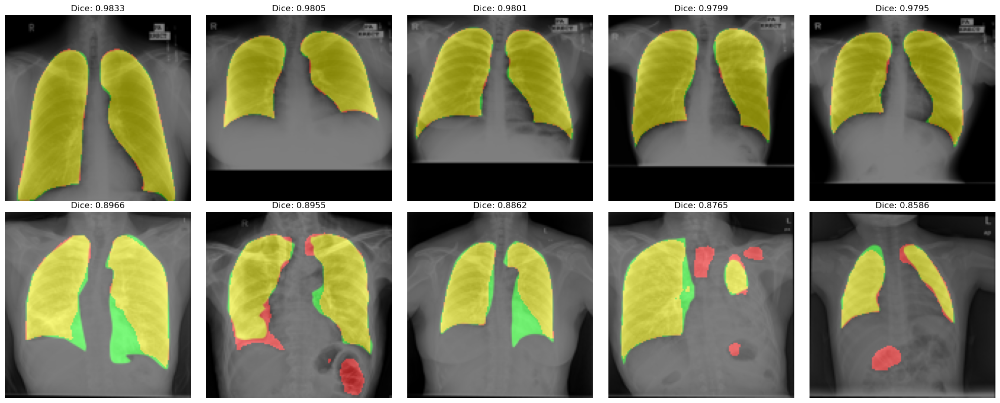

In [22]:
# Se obtienen los 5 mejores y peores resultados del modelo U-Net con optimizador Adam
visualizeBestWorstImages(images_results_unet_adam)

<h3>Gráfico de barras de Coeficiente de Dice usando U-Net con optimizador Adam</h3>
Se crea y utiliza la función <b>plotDiceScores()</b> para crear un gráfico de barras que muestra el Coeficiente de Dice obtenido en cada Imágen del conjunto de prueba.

In [23]:
'''
Entrada: Una lista que contiene los valores del Coeficiente de Dice y el nombre del modelo de segmentación utilizado
Salida: No tiene como tal, pero muestra un gráfico de barras
Descripción: Función que crea un gráfico de barras que muestra los Coeficiente de Dice de cada imágen del conjunto de prueba.
'''
def plotDiceScores(dice_list, model_name):
    plt.figure(figsize=(20, 10))
    plt.bar(range(len(dice_list)), dice_list, color='blue')
    plt.xlabel('Imágen de Prueba')
    plt.ylabel('Coeficiente de Dice')
    plt.title('Coeficiente de Dice para cada Imágen de Prueba usando ' + model_name)
    plt.xticks(range(len(dice_list)), [f'{i+1}' for i in range(len(dice_list))], rotation=90)
    plt.ylim(0, 1) 
    plt.grid(True)
    plt.show()

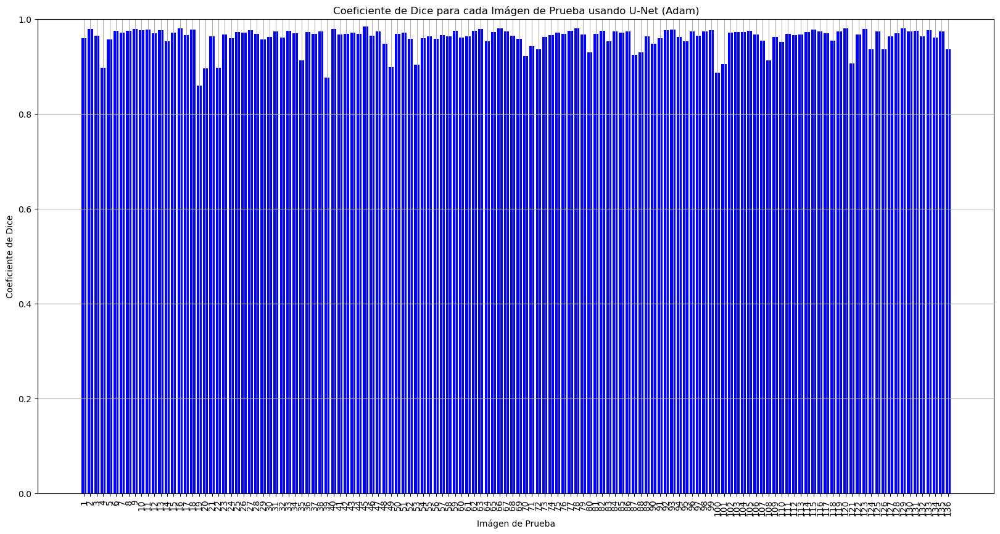

In [24]:
# Se muestra el gráfico de barras de los Coeficiente de Dice usando U-Net con el optimizador Adam
plotDiceScores(dice_list_unet_adam, "U-Net (Adam)")

<h2>U-Net utilizando el optimizador SGD</h2>
Ahora se prueba el modelo U-Net con el optimizador SGD, para ver que tanto difieren los resultados de los obtenidos con el optimizador Adam. Para ello, la tercera entrada de la función <b>createModel()</b> debe ser 2, mientras que las otras se mantienen en 1 para crear así un modelo U-Net que utilce un optimizador SGD con la función de pérdida BCEWithLogitsLoss.

In [25]:
# Se crea un modelo U-Net con optimizador SGD y función de pérdida BCEWithLogitsLoss
model_unet_sgd, loss_fn, optimizer = createModel(1, 1, 2)

<h3>Entrenamiento, evaluaciones y coeficiente de dice de U-Net utilizando SGD</h3>
Se realiza el llamado a la función <b>trainAndEvaluate()</b> usando el <b>modelo U-Net con optimizador SGD</b>. Se puede ver a continuación los resultados en cada época, es decir, los valores de loss de entrenamiento, loss de evaluación y Coeficiente de Dice.

In [26]:
# Se obtienen los resultados de U-Net con el optimizador SGD y la función de pérdida BCEWithLogitsLoss.
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unet_sgd, train_loader, val_loader, optimizer, loss_fn)

Epoch 1/30, Train Loss: 0.7732, Val Loss: 0.7432, Dice Score: 0.3896
Epoch 2/30, Train Loss: 0.7375, Val Loss: 0.7873, Dice Score: 0.3713
Epoch 3/30, Train Loss: 0.7077, Val Loss: 0.7430, Dice Score: 0.3680
Epoch 4/30, Train Loss: 0.6846, Val Loss: 0.6908, Dice Score: 0.3656
Epoch 5/30, Train Loss: 0.6640, Val Loss: 0.6610, Dice Score: 0.3639
Epoch 6/30, Train Loss: 0.6458, Val Loss: 0.6415, Dice Score: 0.3665
Epoch 7/30, Train Loss: 0.6311, Val Loss: 0.6229, Dice Score: 0.3617
Epoch 8/30, Train Loss: 0.6177, Val Loss: 0.6111, Dice Score: 0.3573
Epoch 9/30, Train Loss: 0.6057, Val Loss: 0.6003, Dice Score: 0.3501
Epoch 10/30, Train Loss: 0.5944, Val Loss: 0.5906, Dice Score: 0.3468
Epoch 11/30, Train Loss: 0.5860, Val Loss: 0.5822, Dice Score: 0.3363
Epoch 12/30, Train Loss: 0.5767, Val Loss: 0.5730, Dice Score: 0.3329
Epoch 13/30, Train Loss: 0.5677, Val Loss: 0.5648, Dice Score: 0.3294
Epoch 14/30, Train Loss: 0.5602, Val Loss: 0.5596, Dice Score: 0.3264
Epoch 15/30, Train Loss: 0.55

<h3>Gráfico de Epoch VS Loss usando U-Net con SGD</h3>
Se utiliza la función <b>plotTrainLoss()</b> que muestra un gráfico de como cambia el valor de loss por cada epoch.

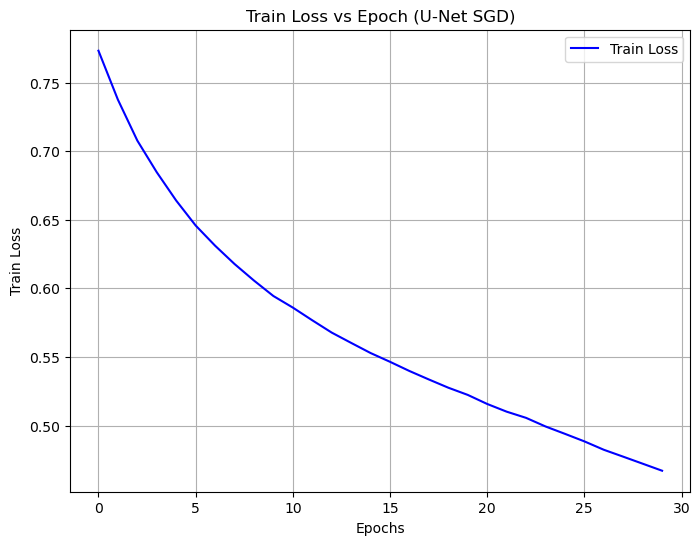

In [27]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net usando SGD 
plotTrainLoss(30, train_loss_history, '(U-Net SGD)')

<h3>Gráfico de Coeficiente de Dice VS Epoch usando U-Net con SGD</h3>
Se utiliza la función <b>plotDiceEpoch()</b> que muestra un gráfico de como cambia el valor de Coeficiente de Dice por cada epoch.

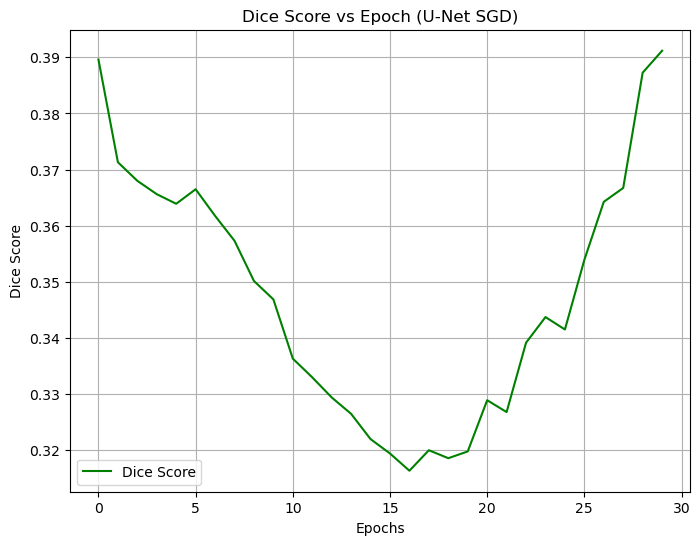

In [28]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net usando SGD
plotDiceEpoch(30, dice_score_history, '(U-Net SGD)')

<h3>Visualización de resultados de U-Net con optimizador SGD</h3>
Se utiliza la función <b>visualizeAllTestImages()</b> para obtener las predicciones realizadas por el modelo U-Net que utiza el optimizador SGD.

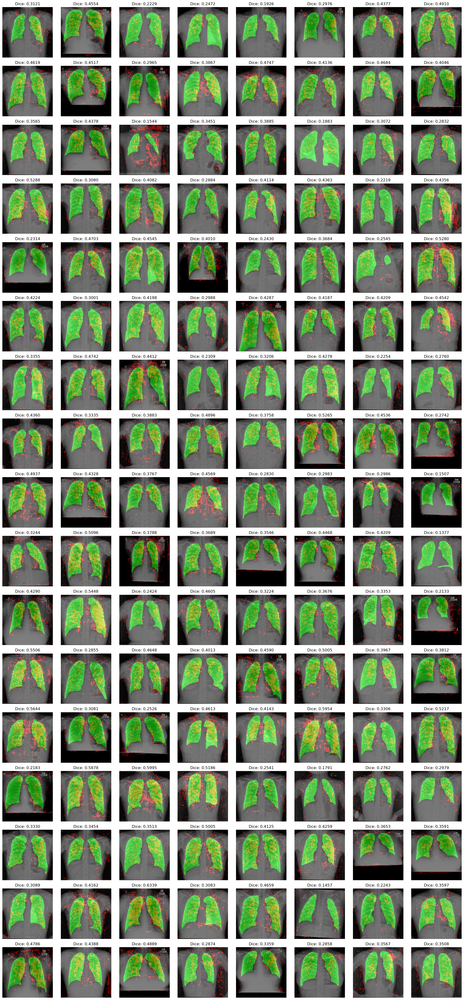

In [29]:
# Se obtienen los resultados y Coeficientes de Dice del modelo U-Net que utiliza el optimizador SGD
dice_list_unet_sgd, images_results_unet_sgd = visualizeAllTestImages(model_unet_sgd, val_loader)

<h3>5 casos dificiles y 5 casos fáciles con U-Net utilizando el optimizador SGD</h3>
Se utiliza la función <b>visualizeBestWorstImages()</b> para obtener los 5 casos que al modelo "le costó" predecir" y los 5 casos en el que el modelo "pudo predecir con facilidad". Nótese que los resultados difieren bastantes con los obtenidos con Adam.

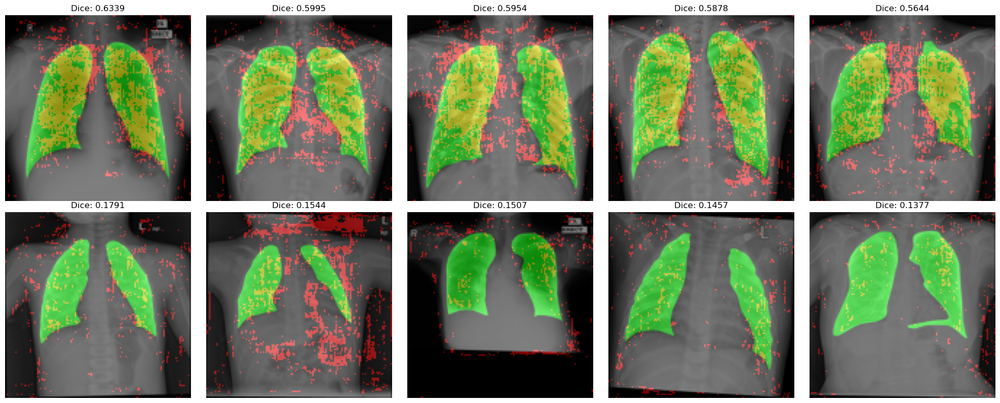

In [30]:
# Se obtienen los 5 mejores y peores resultados del modelo U-Net con optimizador SGD
visualizeBestWorstImages(images_results_unet_sgd)

<h3>Gráfico de barras de Coeficiente de Dice usando U-Net con optimizador SGD</h3>
Se utiliza la función <b>plotDiceScores()</b> para obtener el gráfico de barras que muestra los Coeficientes de Dice por cada una de las 136 imágenes del conjunto de prueba.

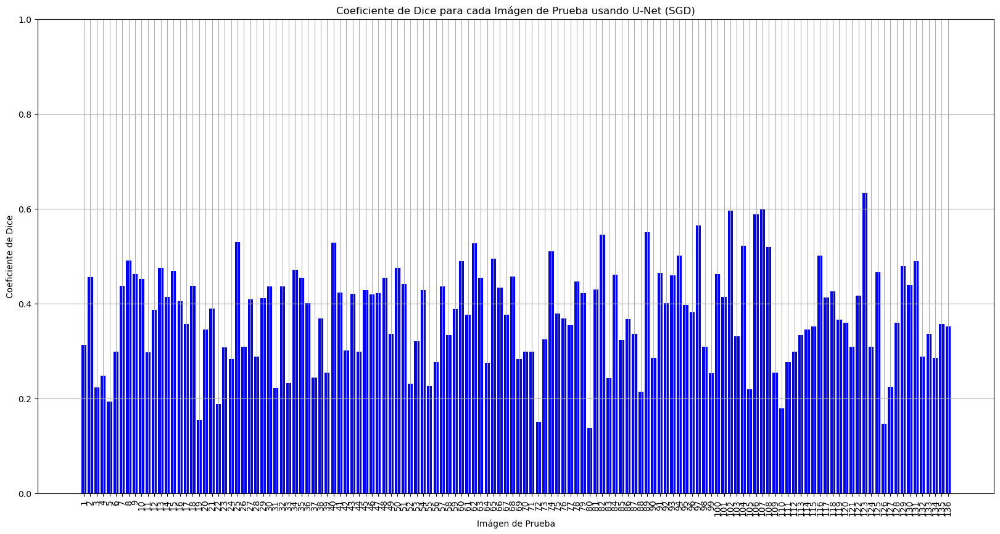

In [31]:
# Se muestra el gráfico de barra de los Coeficiente de Dice usando U-Net con el optimizador SGD
plotDiceScores(dice_list_unet_sgd, "U-Net (SGD)")

Considerando los resultados obtenidos y el gráfico de Coeficiente de Dice, se puede concluir que para el modelo U-Net el mejor optimizador a utilizar es Adam, pues permite obtener mejores resultados que SGD.

<h3>Tabla y comparación de valores de Coeficiente de Dice en U-Net</h3>

Se crea la función <b>createDataTable()</b> la cual crea un dataframe de Pandas de dos columnas (una tabla y muestra la información asociada.
También imprime el valor máximo y minimo asociado a cada columna, lo que permite hacer comparaciones entre los valores obtenidos por cada optimizador.

In [32]:
'''
Entrada: Dos strings (nombres de etiquetas) y dos listas
Salida: No tiene como tal, pero muestra un dataframe de Pandas
Descripción: Función que crea un dataframe de Pandas de dos columnas y muestra la información asociada.
También imprime el valor máximo y minimo asociado a cada columna.
'''
def createDataTable(tag1, data1, tag2, data2):
    max_data1 = max(data1)
    print("Coeficiente de Dice máximo usando el optimizador " + tag1 + " " + str(max_data1))
    min_data1 = min(data1)
    print("Coeficiente de Dice minimo usando el optimizador " + tag1 + " " + str(min_data1))
    max_data2 = max(data2)
    print("Coeficiente de Dice máximo usando el optimizador " + tag2 + " " + str(max_data2))
    min_data2 = min(data2)
    print("Coeficiente de Dice minimo usando el optimizador " + tag2 + " " + str(min_data2))
    data = {tag1: data1,
           tag2: data2,
        }
    df = pd.DataFrame(data)
    display(df) 

# Se cambia la configuración para mostrar todas las filas en el dataframe de pandas
pd.set_option('display.max_rows', None)

In [33]:
# Se crea una tabla que muestra los valores de Coeficiente de Dice de cada optimizador
createDataTable('Adam',dice_list_unet_adam, 'SGD', dice_list_unet_sgd) 

Coeficiente de Dice máximo usando el optimizador Adam 0.9833469390869141
Coeficiente de Dice minimo usando el optimizador Adam 0.8586416840553284
Coeficiente de Dice máximo usando el optimizador SGD 0.633872926235199
Coeficiente de Dice minimo usando el optimizador SGD 0.13768763840198517


,Adam,SGD
0,0.958602,0.312066
1,0.978049,0.455364
2,0.963767,0.222874
3,0.897005,0.247213
4,0.955973,0.192577
5,0.974635,0.297558
6,0.971059,0.437742
7,0.974289,0.490954
8,0.978430,0.461879
9,0.976698,0.451742


<h2>Modificación de hyperparámetros de U-Net con optimizador Adam</h2>
Dado lo anterior, se utilizará el optimizador Adam para la modificación de hyperparámetros. Para esta experiencia, se realizarán dos modificaciones especificas, comparando los resultados de entrenamiento y evaluación junto con los gráficos de loss vs epoch y dice vs epoch, con tal de no sobrecargar de output. Las pruebas son:

* Aumento de número de epochs
* Cambio de la función de pérdida por DiceLoss.

<h3>Entrenamiento y evaluación de U-Net con optimizador Adam usando 100 epochs</h3>
Para evitar problemas con el entrenamiento y evaluación, se vuelve a crear el modelo utilizando la función <b>createModel()</b>. Luego, a la hora de utilizar la función <b>trainAndEvaluate</b>, el número de epochs se cambiará de 30 (valor por defecto) a 100. 

In [34]:
# Creación del modelo U-Net con optimizador Adam y BCEWithLogitsLoss (misma configuración inicial)
model_unet_adam_epochs, loss_fn, optimizer = createModel(1, 1, 1)

In [35]:
# Se obtienen los resultados de U-Net con el optimizador Adam y la función de pérdida BCEWithLogitsLoss usando 100 epochs.
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unet_adam_epochs, train_loader, val_loader, optimizer, loss_fn, 100)

Epoch 1/100, Train Loss: 0.3803, Val Loss: 0.3630, Dice Score: 0.8141
Epoch 2/100, Train Loss: 0.1713, Val Loss: 0.1533, Dice Score: 0.9230
Epoch 3/100, Train Loss: 0.1071, Val Loss: 0.0877, Dice Score: 0.9533
Epoch 4/100, Train Loss: 0.0816, Val Loss: 0.0713, Dice Score: 0.9567
Epoch 5/100, Train Loss: 0.0701, Val Loss: 0.0650, Dice Score: 0.9582
Epoch 6/100, Train Loss: 0.0617, Val Loss: 0.0618, Dice Score: 0.9590
Epoch 7/100, Train Loss: 0.0576, Val Loss: 0.0584, Dice Score: 0.9591
Epoch 8/100, Train Loss: 0.0556, Val Loss: 0.0603, Dice Score: 0.9558
Epoch 9/100, Train Loss: 0.0540, Val Loss: 0.0593, Dice Score: 0.9574
Epoch 10/100, Train Loss: 0.0516, Val Loss: 0.0581, Dice Score: 0.9556
Epoch 11/100, Train Loss: 0.0476, Val Loss: 0.0569, Dice Score: 0.9588
Epoch 12/100, Train Loss: 0.0452, Val Loss: 0.0537, Dice Score: 0.9602
Epoch 13/100, Train Loss: 0.0432, Val Loss: 0.0522, Dice Score: 0.9618
Epoch 14/100, Train Loss: 0.0414, Val Loss: 0.0571, Dice Score: 0.9597
Epoch 15/100, T

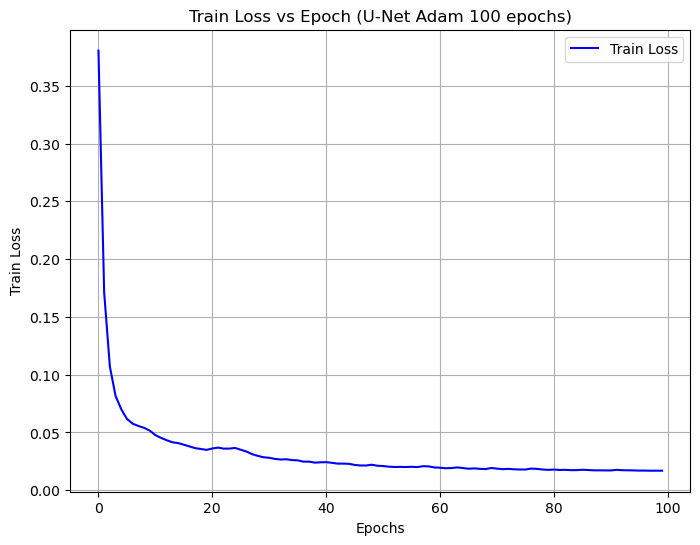

In [36]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net usando Adam.
plotTrainLoss(100, train_loss_history, '(U-Net Adam 100 epochs)')

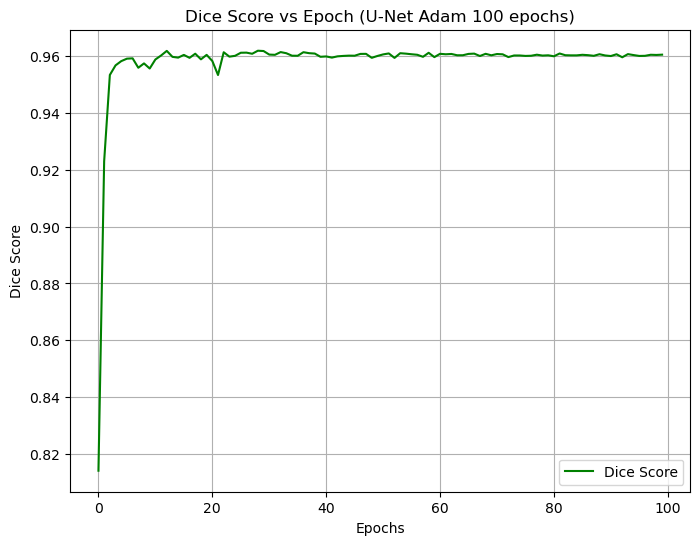

In [37]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net usando Adam.
plotDiceEpoch(100, dice_score_history, '(U-Net Adam 100 epochs)')

<h3>Entrenamiento y evaluación de U-Net con optimizador Adam y función de pérdida DiceLoss</h3>
Se crea el modelo utilizando la función <b>createModel()</b>, esta vez con el segundo parametro de entrada correspondiente a 2, para utilizar la función de pérdida DiceLoss. No se modifica el número de epochs (se mantiene el valor por defecto de 30)

In [38]:
# Creación del modelo U-Net con optimizador Adam y función de pérdida DiceLoss
model_unet_adam_loss, loss_fn, optimizer = createModel(1, 2, 1)

In [39]:
# Se obtienen los resultados de U-Net con el optimizador Adam y la función de pérdida DiceLoss
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unet_adam_loss, train_loader, val_loader, optimizer, loss_fn)

Epoch 1/30, Train Loss: 0.3884, Val Loss: 0.4067, Dice Score: 0.6585
Epoch 2/30, Train Loss: 0.2392, Val Loss: 0.2293, Dice Score: 0.9032
Epoch 3/30, Train Loss: 0.1534, Val Loss: 0.1275, Dice Score: 0.9516
Epoch 4/30, Train Loss: 0.1002, Val Loss: 0.0864, Dice Score: 0.9582
Epoch 5/30, Train Loss: 0.0747, Val Loss: 0.0761, Dice Score: 0.9514
Epoch 6/30, Train Loss: 0.0620, Val Loss: 0.0611, Dice Score: 0.9592
Epoch 7/30, Train Loss: 0.0551, Val Loss: 0.0611, Dice Score: 0.9546
Epoch 8/30, Train Loss: 0.0523, Val Loss: 0.0518, Dice Score: 0.9607
Epoch 9/30, Train Loss: 0.0488, Val Loss: 0.0492, Dice Score: 0.9604
Epoch 10/30, Train Loss: 0.0460, Val Loss: 0.0479, Dice Score: 0.9611
Epoch 11/30, Train Loss: 0.0445, Val Loss: 0.0478, Dice Score: 0.9598
Epoch 12/30, Train Loss: 0.0430, Val Loss: 0.0503, Dice Score: 0.9563
Epoch 13/30, Train Loss: 0.0420, Val Loss: 0.0574, Dice Score: 0.9476
Epoch 14/30, Train Loss: 0.0410, Val Loss: 0.0487, Dice Score: 0.9562
Epoch 15/30, Train Loss: 0.03

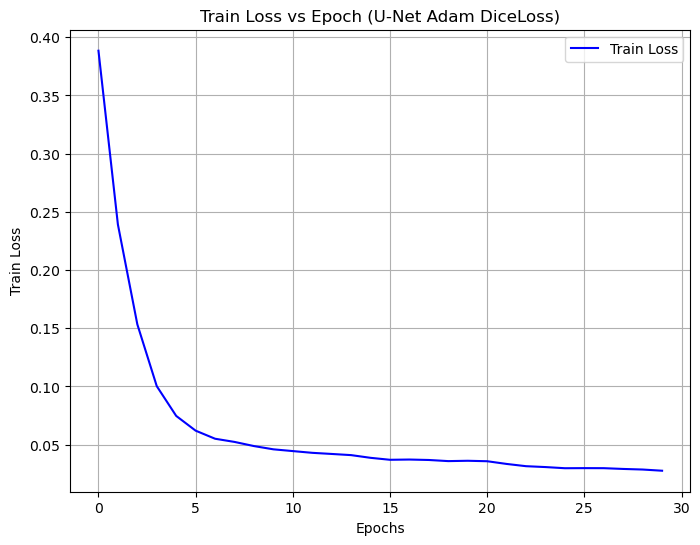

In [40]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net usando Adam y DiceLoss.
plotTrainLoss(30, train_loss_history, '(U-Net Adam DiceLoss)')

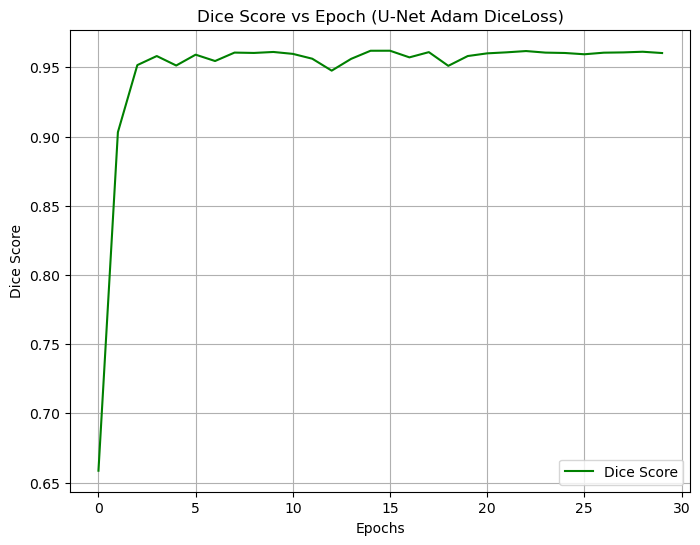

In [41]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net usando Adam y DiceLoss.
plotDiceEpoch(30, dice_score_history, '(U-Net Adam DiceLoss)')

Se puede observar que con tanto en el aumento de epochs como en la modificación de la función de pérdida, los resultados cambian levemente, pero manteniendose con buenos valores a la hora de revisar loss y Coeficiente de Dice.

<h2>U-Net++ utilizando el optimizador Adam</h2>
Ahora, se va a realizar todo lo que se ha realizado anteriormente, solo que ahora utilizando el modelo U-Net++, una evolución de U-Net. Para ello, nuevamente se hace uso de Segmentation Models, que ya contiene una implementación del modelo U-Net++ listo para crear y utilizar. Se utiliza la función <b>createModel()</b> con la primera entrada correspondiente al valor 2 para utilizar U-Net++. El resto de entradas se mantienen en 1, para utilizar el optimizador Adam y la función de pérdida BCEWithLogitsLoss

In [42]:
# Creación del modelo U-Net con optimizador Adam y BCEWithLogitsLoss
model_unetpp_adam, loss_fn, optimizer = createModel(2, 1, 1)
model_unetpp_adam

UnetPlusPlus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=Tru

<h3>Entrenamiento, evaluaciones y Coeficiente de Dice de U-Net++ utilizando Adam</h3>
Se realiza el llamado a la función <b>trainAndEvaluate()</b> usando el <b>modelo U-Net++ con optimizador Adam</b>. Se puede ver a continuación los resultados en cada época, es decir, los valores de loss de entrenamiento, loss de evaluación y Coeficiente de Dice.

In [43]:
# Se obtienen los resultados de U-Net++ con el optimizador Adam y la función de pérdida BCEWithLogitsLoss.
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unetpp_adam, train_loader, val_loader, optimizer, loss_fn)

Epoch 1/30, Train Loss: 0.3093, Val Loss: 0.3843, Dice Score: 0.8294
Epoch 2/30, Train Loss: 0.1271, Val Loss: 0.1249, Dice Score: 0.9376
Epoch 3/30, Train Loss: 0.0854, Val Loss: 0.0800, Dice Score: 0.9544
Epoch 4/30, Train Loss: 0.0697, Val Loss: 0.0683, Dice Score: 0.9557
Epoch 5/30, Train Loss: 0.0597, Val Loss: 0.0715, Dice Score: 0.9512
Epoch 6/30, Train Loss: 0.0571, Val Loss: 0.0586, Dice Score: 0.9589
Epoch 7/30, Train Loss: 0.0535, Val Loss: 0.0594, Dice Score: 0.9562
Epoch 8/30, Train Loss: 0.0497, Val Loss: 0.0560, Dice Score: 0.9591
Epoch 9/30, Train Loss: 0.0458, Val Loss: 0.0561, Dice Score: 0.9600
Epoch 10/30, Train Loss: 0.0448, Val Loss: 0.0588, Dice Score: 0.9552
Epoch 11/30, Train Loss: 0.0411, Val Loss: 0.0534, Dice Score: 0.9605
Epoch 12/30, Train Loss: 0.0399, Val Loss: 0.0549, Dice Score: 0.9607
Epoch 13/30, Train Loss: 0.0381, Val Loss: 0.0544, Dice Score: 0.9611
Epoch 14/30, Train Loss: 0.0356, Val Loss: 0.0557, Dice Score: 0.9605
Epoch 15/30, Train Loss: 0.03

<h3>Gráfico de Epoch VS Loss usando U-Net++ con Adam</h3>
Se utiliza la función <b>plotTrainLoss()</b> que muestra un gráfico de como cambia el valor de loss por cada epoch.

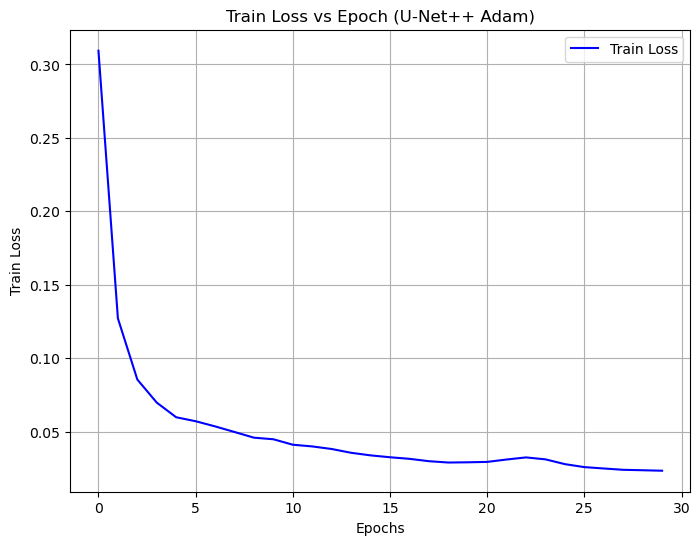

In [44]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net++ usando Adam.
plotTrainLoss(30, train_loss_history, '(U-Net++ Adam)')

<h3>Gráfico de Coeficiente de Dice VS Epoch usando U-Net++ con Adam</h3>
Se utiliza la función <b>plotDiceEpoch()</b> que muestra un gráfico de como cambia el valor de Coeficiente de Dice por cada epoch.

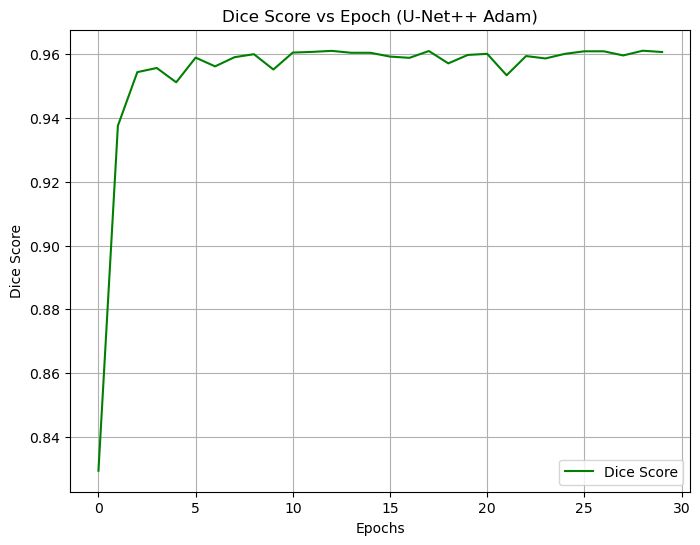

In [45]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net++ usando Adam
plotDiceEpoch(30, dice_score_history, '(U-Net++ Adam)')

<h3>Visualización de resultados de U-Net++ con optimizador Adam</h3>
Se utiliza la función <b>visualizeAllTestImages()</b> para obtener las predicciones realizadas por el modelo U-Net++ que utiza el optimizador Adam.

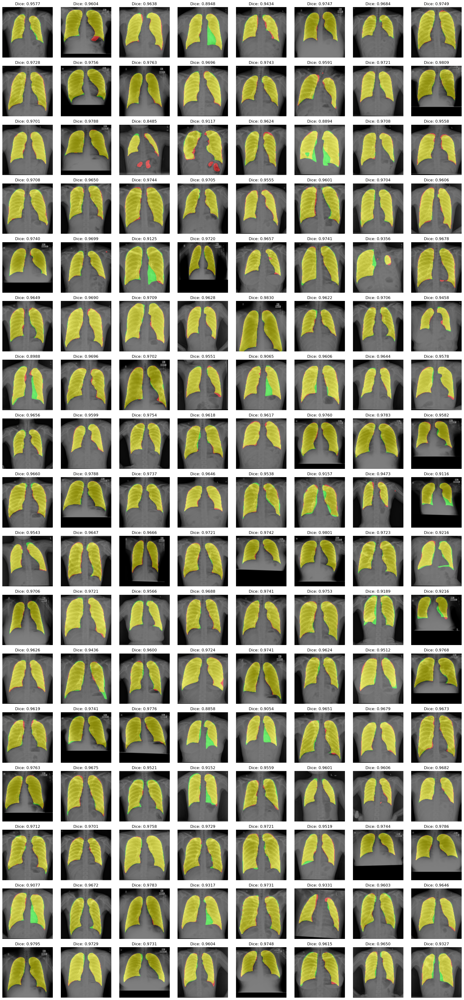

In [46]:
# Se obtienen los resultados y Coeficientes de Dice del modelo U-Net++ que utiliza el optimizador Adam
dice_list_unetpp_adam, images_results_unetpp_adam = visualizeAllTestImages(model_unetpp_adam, val_loader)

<h3>5 casos dificiles y 5 casos fáciles con U-Net++ utilizando el optimizador Adam</h3>
Se utiliza la función <b>visualizeBestWorstImages()</b> para obtener los 5 dificiles (peores valores de Coeficiente de Dice) y 5 casos faciles (mejores valores de Coeficiente de Dice) para U-Net++ con optimizador Adam.

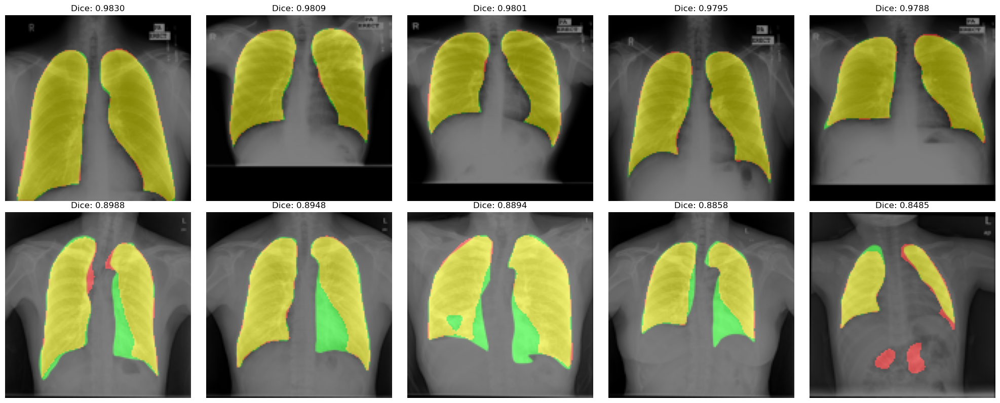

In [47]:
# Se obtienen los 5 mejores y peores resultados del modelo U-Net++ con optimizador Adam
visualizeBestWorstImages(images_results_unetpp_adam)

<h3>Gráfico de barras de Coeficiente de Dice usando U-Net++ con optimizador Adam</h3>
Se utiliza la función <b>plotDiceScores()</b> para obtener el gráfico de barras que muestra los Coeficientes de Dice por cada una de las 136 imágenes del conjunto de prueba.

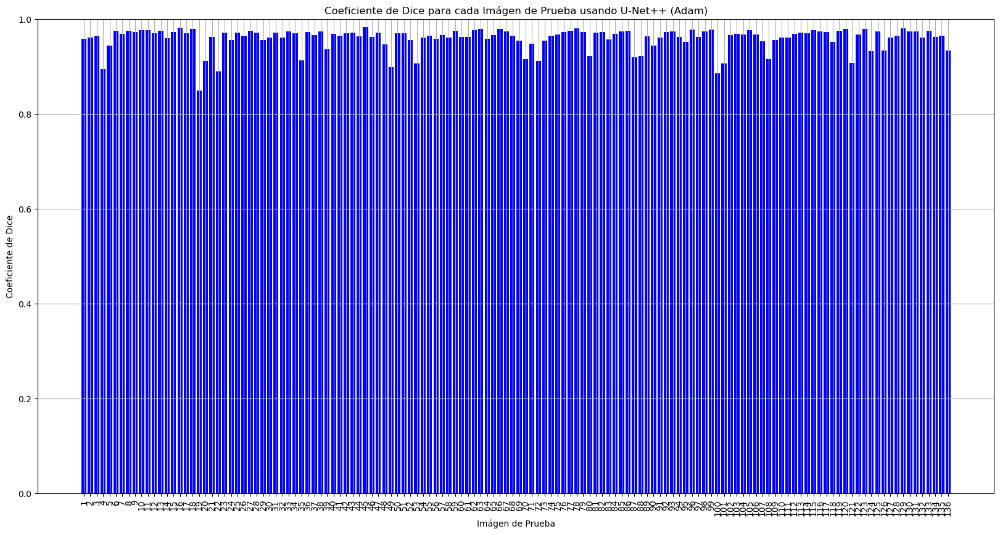

In [48]:
# Se muestra el gráfico de barra de los Coeficiente de Dice usando U-Net++ con el optimizador Adam
plotDiceScores(dice_list_unetpp_adam, "U-Net++ (Adam)")

<h2>U-Net++ utilizando el optimizador SGD</h2>
Similar a como fue con U-Net, se prueba el modelo U-Net++ con el optimizador SGD, para ver que tanto difieren los resultados de los obtenidos con el optimizador Adam. Para ello, la tercera entrada de la función <b>createModel()</b> debe ser 2, para crear así un modelo U-Net++ que utilce un optimizador SGD con la función de pérdida BCEWithLogitsLoss.

In [49]:
# Se crea un modelo U-Net++ con optimizador SGD y función de pérdida BCEWithLogitsLoss
model_unetpp_sgd, loss_fn, optimizer = createModel(2, 1, 2)

<h3>Entrenamiento, evaluaciones y coeficiente de dice de U-Net++ utilizando SGD</h3>
Se realiza el llamado a la función <b>trainAndEvaluate()</b> usando el <b>modelo U-Net++ con optimizador SGD</b>. Se puede ver a continuación los resultados en cada época, es decir, los valores de loss de entrenamiento, loss de evaluación y coeficiente de dice.

In [50]:
# Se obtienen los resultados de U-Net++ con el optimizador SGD y la función de pérdida BCEWithLogitsLoss.
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unetpp_sgd, train_loader, val_loader, optimizer, loss_fn)

Epoch 1/30, Train Loss: 0.7417, Val Loss: 0.6899, Dice Score: 0.3313
Epoch 2/30, Train Loss: 0.7051, Val Loss: 0.6839, Dice Score: 0.3582
Epoch 3/30, Train Loss: 0.6741, Val Loss: 0.6611, Dice Score: 0.3706
Epoch 4/30, Train Loss: 0.6478, Val Loss: 0.6353, Dice Score: 0.3724
Epoch 5/30, Train Loss: 0.6247, Val Loss: 0.6112, Dice Score: 0.3826
Epoch 6/30, Train Loss: 0.6037, Val Loss: 0.5893, Dice Score: 0.4024
Epoch 7/30, Train Loss: 0.5841, Val Loss: 0.5702, Dice Score: 0.4186
Epoch 8/30, Train Loss: 0.5662, Val Loss: 0.5526, Dice Score: 0.4389
Epoch 9/30, Train Loss: 0.5488, Val Loss: 0.5361, Dice Score: 0.4561
Epoch 10/30, Train Loss: 0.5325, Val Loss: 0.5199, Dice Score: 0.4798
Epoch 11/30, Train Loss: 0.5163, Val Loss: 0.5039, Dice Score: 0.5020
Epoch 12/30, Train Loss: 0.5008, Val Loss: 0.4887, Dice Score: 0.5259
Epoch 13/30, Train Loss: 0.4854, Val Loss: 0.4738, Dice Score: 0.5508
Epoch 14/30, Train Loss: 0.4708, Val Loss: 0.4600, Dice Score: 0.5752
Epoch 15/30, Train Loss: 0.45

<h3>Gráfico de Epoch VS Loss usando U-Net++ con SGD</h3>
Se utiliza la función <b>plotTrainLoss()</b> que muestra un gráfico de como cambia el valor de loss por cada epoch.

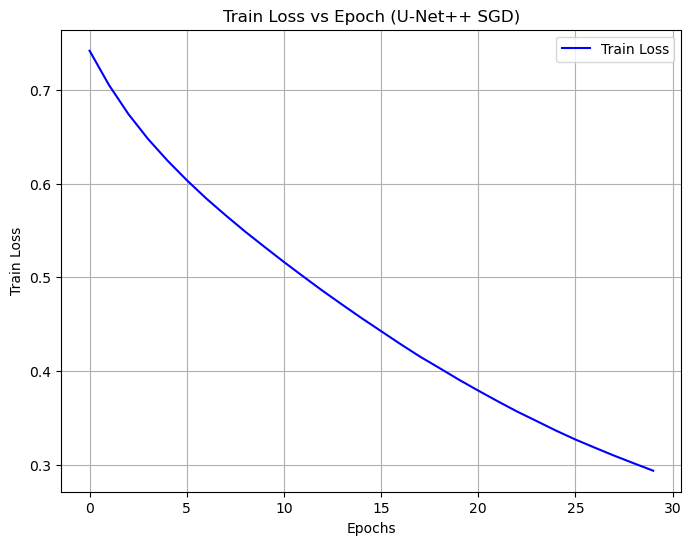

In [51]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net++ usando SGD 
plotTrainLoss(30, train_loss_history, '(U-Net++ SGD)')

<h3>Gráfico de Coeficiente de Dice VS Epoch usando U-Net++ con SGD</h3>
Se utiliza la función <b>plotDiceEpoch()</b> que muestra un gráfico de como cambia el valor de Coeficiente de Dice por cada epoch.

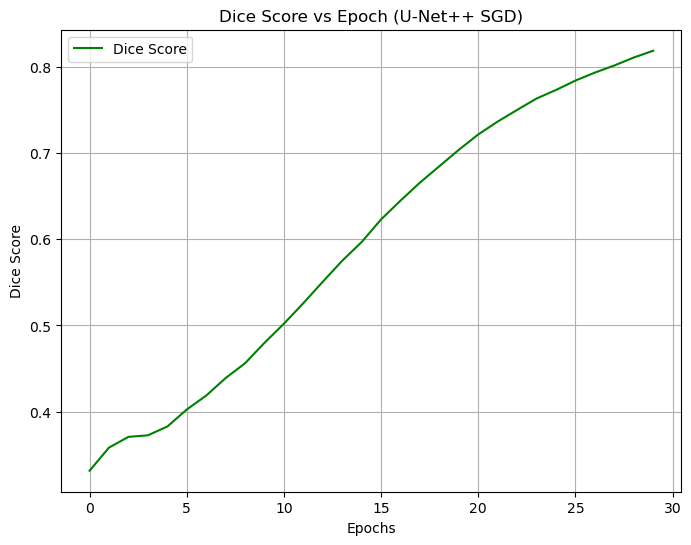

In [52]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net++ usando SGD
plotDiceEpoch(30, dice_score_history, '(U-Net++ SGD)')

<h3>Visualización de resultados de U-Net++ con optimizador SGD</h3>
Se utiliza la función <b>visualizeAllTestImages()</b> para obtener las predicciones realizadas por el modelo U-Net++ que utiza el optimizador SGD.

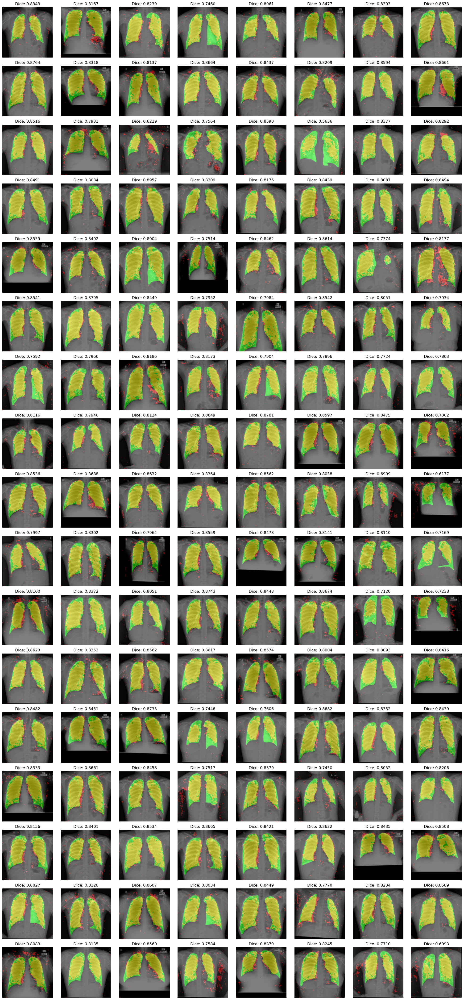

In [53]:
# Se obtienen los resultados y Coeficientes de Dice del modelo U-Net++ que utiliza el optimizador SGD
dice_list_unetpp_sgd, images_results_unetpp_sgd = visualizeAllTestImages(model_unetpp_sgd, val_loader)

<h3>5 casos dificiles y 5 casos fáciles con U-Net++ utilizando el optimizador SGD</h3>
Se utiliza la función <b>visualizeBestWorstImages()</b> para obtener los 5 casos que al modelo "le costó" predecir" y los 5 casos en el que el modelo "pudo predecir con facilidad". Nótese que los resultados difieren bastantes con los obtenidos con Adam, pero son mucho mejores que los obtenidos al usar U-Net con SGD.

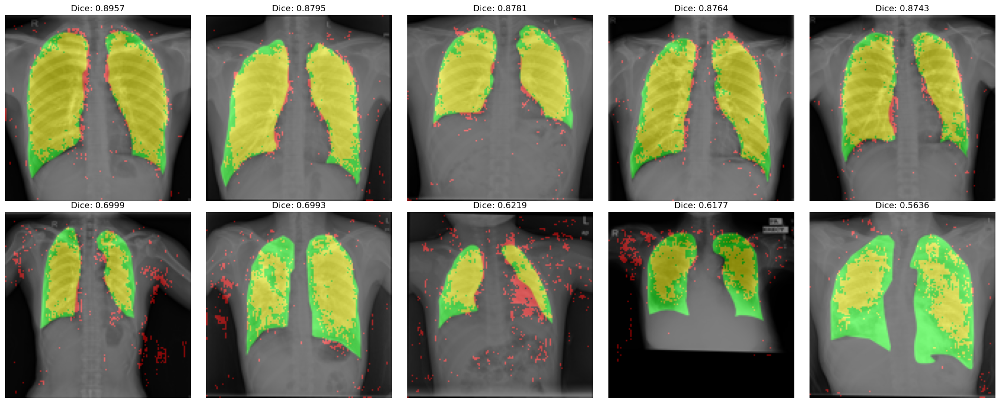

In [54]:
# Se obtienen los 5 mejores y peores resultados del modelo U-Net++ con optimizador SGD
visualizeBestWorstImages(images_results_unetpp_sgd)

<h3>Gráfico de barras de Coeficiente de Dice usando U-Net++ con optimizador SGD</h3>
Se utiliza la función <b>plotDiceScores()</b> para obtener el gráfico de barras que muestra los Coeficientes de Dice por cada una de las 136 imágenes del conjunto de prueba.

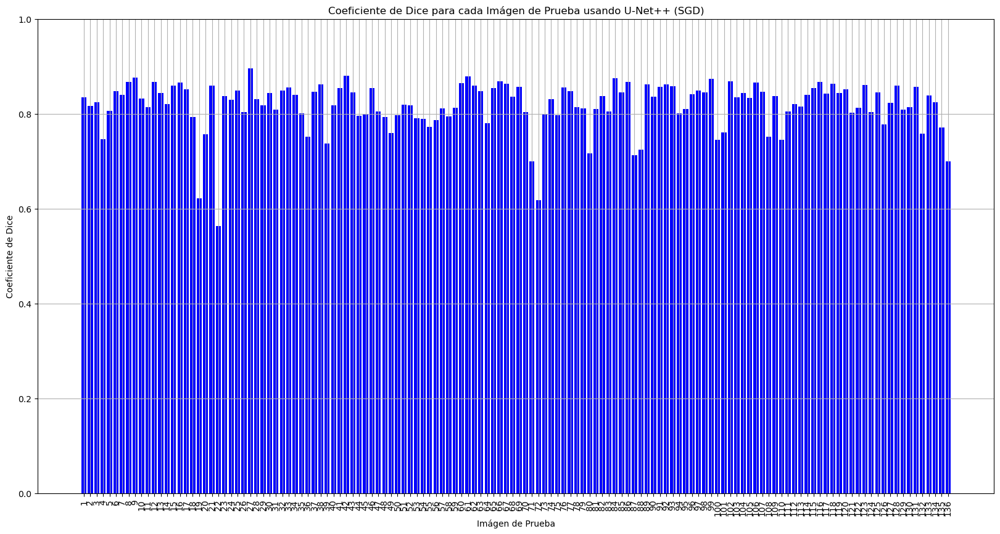

In [55]:
# Se muestra el gráfico de barra de los Coeficiente de Dice usando U-Net++ con el optimizador SGD
plotDiceScores(dice_list_unetpp_sgd, "U-Net++ (SGD)")

A la hora de ver los resultados de U-Net++, si se utiliza el optimizador Adam, no se ve mucha diferencia comparado con U-Net, ya que ambos modelos obtienen buenos valores de Coeficiente de Dice y realizan buenas predicciones. Sin embargo, al utilizar el optimizador SGD, se ve mucho más claro que U-Net++ es superior a U-Net, ya que es capaz de realizar mejores predicciones y obtener valores de Coeficiente de Dice más altos y loss más bajos. A pesar de lo anterior, se puede ver que tanto en U-Net como en U-Net++, Adam es superior a la hora de realizar predicciones.


<h3>Tabla y comparación de valores de Coeficiente de Dice en U-Net++</h3>
Se utiliza la función <b>createDataTable()</b> para comparar los valores obtenidos por los optimizadores usando el modelo U-Net++.

In [56]:
# Se crea una tabla que muestra los valores de Coeficiente de Dice de cada optimizador
createDataTable('Adam',dice_list_unetpp_adam, 'SGD', dice_list_unetpp_sgd) 

Coeficiente de Dice máximo usando el optimizador Adam 0.982986569404602
Coeficiente de Dice minimo usando el optimizador Adam 0.8484635353088379
Coeficiente de Dice máximo usando el optimizador SGD 0.8957055807113647
Coeficiente de Dice minimo usando el optimizador SGD 0.563556432723999


,Adam,SGD
0,0.957702,0.834282
1,0.960434,0.816747
2,0.963797,0.823930
3,0.894841,0.745950
4,0.943393,0.806134
5,0.974683,0.847679
6,0.968408,0.839256
7,0.974929,0.867286
8,0.972750,0.876414
9,0.975569,0.831754


<h2>Modificación de hyperparámetros de U-Net++ con optimizador Adam</h2>
Similar a como se hizo con U-Net, se realizarán las mismas pruebas de cambios de hyperparámetros, pero ahora aplicandolo a un modelo U-Net++ que utiliza el optimizador Adam.

<h3>Entrenamiento y evaluación de U-Net++ con optimizador Adam usando 100 epochs</h3>
Para evitar problemas con el entrenamiento y evaluación, se vuelve a crear el modelo utilizando la función <b>createModel()</b>. Luego, a la hora de utilizar la función <b>trainAndEvaluate</b>, el número de epochs se cambiará de 30 (valor por defecto) a 100.

In [57]:
# Creación del modelo U-Net++ con optimizador Adam y BCEWithLogitsLoss (misma configuración inicial)
model_unetpp_adam_epochs, loss_fn, optimizer = createModel(2, 1, 1)

In [58]:
# Se obtienen los resultados de U-Net++ con el optimizador Adam y la función de pérdida BCEWithLogitsLoss usando 100 epochs.
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unetpp_adam_epochs, train_loader, val_loader, optimizer, loss_fn, 100)

Epoch 1/100, Train Loss: 0.3093, Val Loss: 0.3843, Dice Score: 0.8294
Epoch 2/100, Train Loss: 0.1271, Val Loss: 0.1249, Dice Score: 0.9376
Epoch 3/100, Train Loss: 0.0854, Val Loss: 0.0800, Dice Score: 0.9544
Epoch 4/100, Train Loss: 0.0697, Val Loss: 0.0683, Dice Score: 0.9557
Epoch 5/100, Train Loss: 0.0597, Val Loss: 0.0715, Dice Score: 0.9512
Epoch 6/100, Train Loss: 0.0571, Val Loss: 0.0586, Dice Score: 0.9589
Epoch 7/100, Train Loss: 0.0535, Val Loss: 0.0594, Dice Score: 0.9562
Epoch 8/100, Train Loss: 0.0497, Val Loss: 0.0560, Dice Score: 0.9591
Epoch 9/100, Train Loss: 0.0458, Val Loss: 0.0561, Dice Score: 0.9600
Epoch 10/100, Train Loss: 0.0448, Val Loss: 0.0588, Dice Score: 0.9552
Epoch 11/100, Train Loss: 0.0411, Val Loss: 0.0534, Dice Score: 0.9605
Epoch 12/100, Train Loss: 0.0399, Val Loss: 0.0549, Dice Score: 0.9607
Epoch 13/100, Train Loss: 0.0381, Val Loss: 0.0544, Dice Score: 0.9611
Epoch 14/100, Train Loss: 0.0356, Val Loss: 0.0557, Dice Score: 0.9605
Epoch 15/100, T

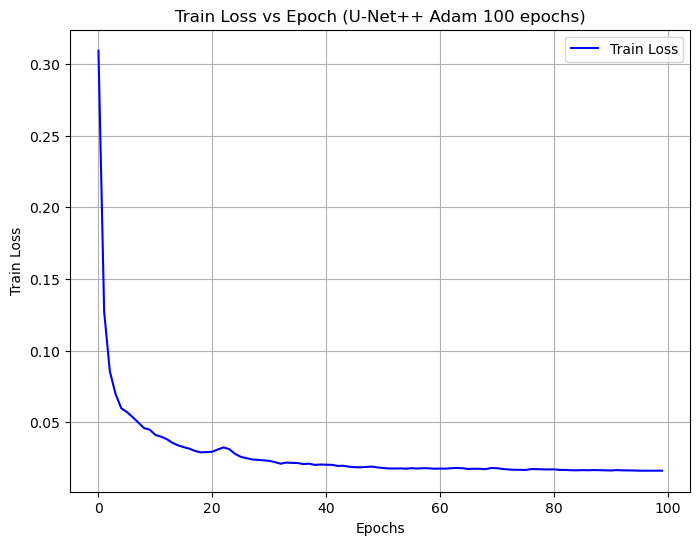

In [59]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net++ usando Adam.
plotTrainLoss(100, train_loss_history, '(U-Net++ Adam 100 epochs)')

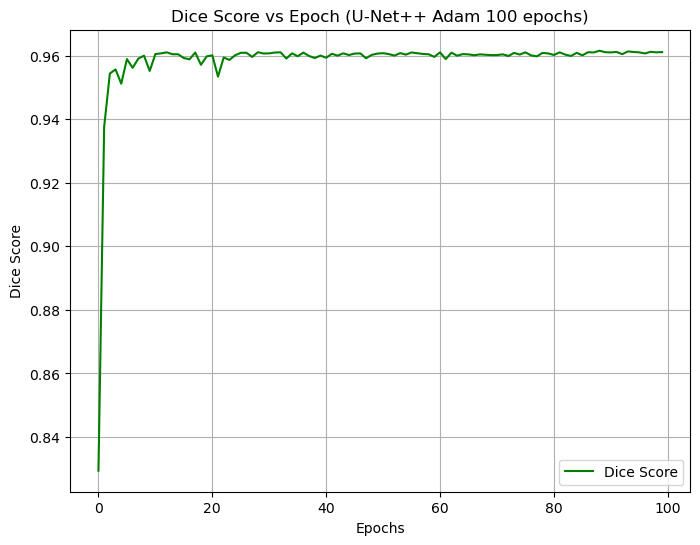

In [60]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net++ usando Adam.
plotDiceEpoch(100, dice_score_history, '(U-Net++ Adam 100 epochs)')

<h3>Entrenamiento y evaluación de U-Net++ con optimizador Adam y función de pérdida DiceLoss</h3>
Se crea el modelo utilizando la función <b>createModel()</b>, esta vez con el segundo parametro de entrada correspondiente a 2, para utilizar la función de pérdida DiceLoss. No se modifica el número de epochs (se mantiene el valor por defecto de 30)

In [61]:
# Creación del modelo U-Net++ con optimizador Adam y función de pérdida DiceLoss
model_unetpp_adam_loss, loss_fn, optimizer = createModel(2, 2, 1)

In [62]:
# Se obtienen los resultados de U-Net++ con el optimizador Adam y la función de pérdida DiceLoss
train_loss_history, val_loss_history, dice_score_history = trainAndEvaluate(model_unetpp_adam_loss, train_loader, val_loader, optimizer, loss_fn)

Epoch 1/30, Train Loss: 0.3604, Val Loss: 0.4142, Dice Score: 0.6762
Epoch 2/30, Train Loss: 0.1979, Val Loss: 0.1782, Dice Score: 0.9318
Epoch 3/30, Train Loss: 0.1161, Val Loss: 0.1027, Dice Score: 0.9529
Epoch 4/30, Train Loss: 0.0770, Val Loss: 0.0716, Dice Score: 0.9595
Epoch 5/30, Train Loss: 0.0615, Val Loss: 0.0595, Dice Score: 0.9594
Epoch 6/30, Train Loss: 0.0531, Val Loss: 0.0536, Dice Score: 0.9597
Epoch 7/30, Train Loss: 0.0499, Val Loss: 0.0489, Dice Score: 0.9621
Epoch 8/30, Train Loss: 0.0460, Val Loss: 0.0476, Dice Score: 0.9610
Epoch 9/30, Train Loss: 0.0446, Val Loss: 0.0518, Dice Score: 0.9559
Epoch 10/30, Train Loss: 0.0431, Val Loss: 0.0456, Dice Score: 0.9607
Epoch 11/30, Train Loss: 0.0401, Val Loss: 0.0440, Dice Score: 0.9615
Epoch 12/30, Train Loss: 0.0382, Val Loss: 0.0434, Dice Score: 0.9614
Epoch 13/30, Train Loss: 0.0368, Val Loss: 0.0434, Dice Score: 0.9611
Epoch 14/30, Train Loss: 0.0350, Val Loss: 0.0427, Dice Score: 0.9616
Epoch 15/30, Train Loss: 0.03

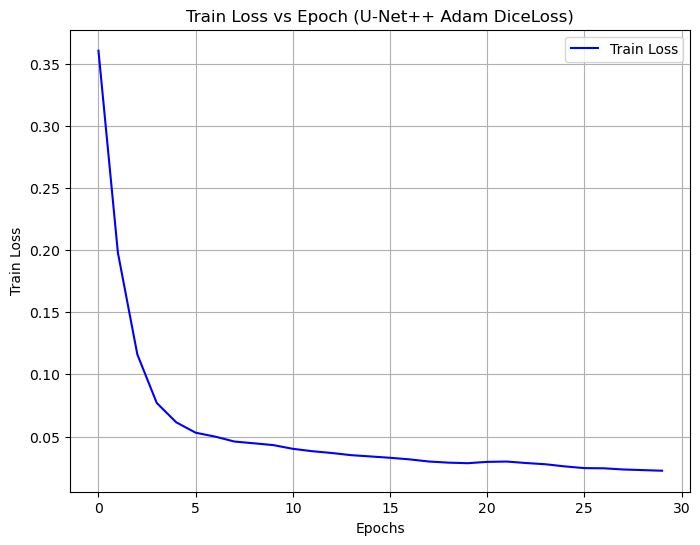

In [63]:
# Se crea y muestra el gráfico de Train Loss VS Epoch para U-Net++ usando Adam y DiceLoss.
plotTrainLoss(30, train_loss_history, '(U-Net++ Adam DiceLoss)')

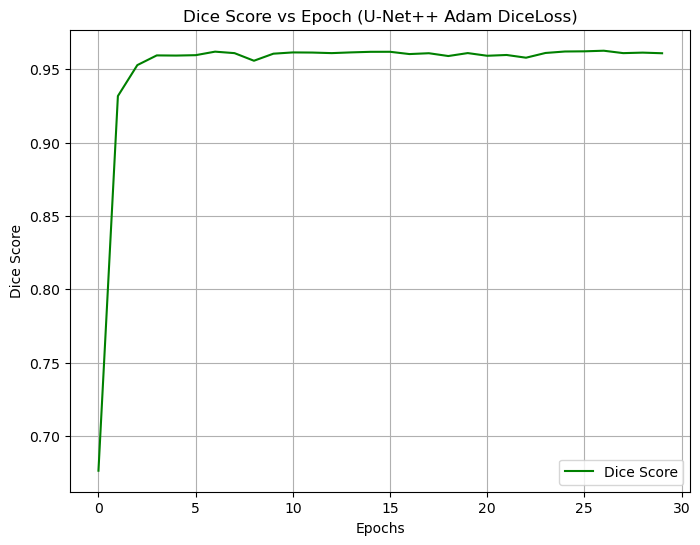

In [64]:
# Se crea y muestra el gráfico de Coeficiente de Dice VS Epoch para U-Net++ usando Adam y DiceLoss.
plotDiceEpoch(30, dice_score_history, '(U-Net++ Adam DiceLoss)')

Se puede apreciar que al igual que con U-Net, a pesar de los cambios de hyperparámetros, los resultados siguen siendo buenos y similares a los obtenidos con los hyperparámetros originales utilizados.

Los analisis relacionados a los resultados se realizan en el informe escrito que acompaña a este código. En él, se revisa el desempeño de los modelos y cuales son las ventajas, desventajas y diferencias que existen entre los modelos y sus configuraciones, entre otros aspectos.